## DSCC202-402 Data Science at Scale Final Project
### Tracking Tweet sentiment at scale using a pretrained transformer (classifier)
<p>Consider the following illustration of the end to end system that you will be building.  Each student should do their own work.  The project will demonstrate your understanding of Spark Streaming, the medalion data architecture using Delta Lake, Spark Inference at Scale using an MLflow packaged model as well as Exploritory Data Analysis and System Tracking and Monitoring.</p>
<br><br>
<img src="https://data-science-at-scale.s3.amazonaws.com/images/pipeline.drawio.png">

<p>
You will be pulling an updated copy of the course GitHub repositiory: <a href="https://github.com/lpalum/dscc202-402-spring2024">The Repo</a>.  If you are unclear on how to pull an updated copy using the GitHub command line, the following <a href="https://techwritingmatters.com/how-to-update-your-forked-repository-on-github">document</a> is helpful.  Be sure to add the professors and TAs as collaborators on your project. 

- lpalum@gmail.com GitHub ID: lpalum
- ajay.anand@rochester.edu GitHub ID: ajayan12
- divyamunot1999@gmail.com GitHub ID: divyamunot
- ylong6@u.Rochester.edu GitHub ID: NinaLong2077

Once you have updates your fork of the repository you should see the following template project that is resident in the final_project directory.
</p>

<img src="https://data-science-at-scale.s3.amazonaws.com/images/notebooks.drawio.png">

<p>
You can then pull your project into the Databrick Workspace using the <a href="https://www.databricks.training/step-by-step/importing-courseware-from-github/index.html">Repos</a> feature.
Each student is expected to submit the URL of their project on GitHub with their code checked in on the main/master branch.  This illustration highlights the branching scheme that you may use to work on your code in steps and then merge your submission into your master branch before submitting.
</p>
<img src="https://data-science-at-scale.s3.amazonaws.com/images/github.drawio.png">
<p>
Work your way through this notebook which will give you the steps required to submit a complete and compliant project.  The following illustration and associated data dictionary specifies the transformations and data that you are to generate for each step in the medallion pipeline.
</p>
<br><br>
<img src="https://data-science-at-scale.s3.amazonaws.com/images/dataframes.drawio.png">

#### Bronze Data - raw ingest
- date - string in the source json
- user - string in the source json
- text - tweet string in the source json
- sentiment - the given sentiment of the text as determined by an unknown model that is provided in the source json
- source_file - the path of the source json file the this row of data was read from
- processing_time - a timestamp of when you read this row from the source json

#### Silver Data - Bronze Preprocessing
- timestamp - convert date string in the bronze data to a timestamp
- mention - every @username mentioned in the text string in the bronze data gets a row in this silver data table.
- cleaned_text - the bronze text data with the mentions (@username) removed.
- sentiment - the given sentiment that was associated with the text in the bronze table.

#### Gold Data - Silver Table Inference
- timestamp - the timestamp from the silver data table rows
- mention - the mention from the silver data table rows
- cleaned_text - the cleaned_text from the silver data table rows
- sentiment - the given sentiment from the silver data table rows
- predicted_score - score out of 100 from the Hugging Face Sentiment Transformer
- predicted_sentiment - string representation of the sentiment
- sentiment_id - 0 for negative and 1 for postive associated with the given sentiment
- predicted_sentiment_id - 0 for negative and 1 for positive assocaited with the Hugging Face Sentiment Transformer

#### Application Data - Gold Table Aggregation
- min_timestamp - the oldest timestamp on a given mention (@username)
- max_timestamp - the newest timestamp on a given mention (@username)
- mention - the user (@username) that this row pertains to.
- negative - total negative tweets directed at this mention (@username)
- neutral - total neutral tweets directed at this mention (@username)
- positive - total positive tweets directed at this mention (@username)

When you are designing your approach, one of the main decisions that you will need to make is how you are going to orchestrate the streaming data processing in your pipeline.  There are several valid approaches.  First, you may choose to start the bronze_stream and let it complete (read and append all of the source data) before preceeding and starting up the silver_stream.  This approach has latency associated with it but it will allow your code to proceed in a linear fashion and process all the data by the end of your notebook execution.  Another potential approach is to start all the streams and have a "watch" method to determine when the pipeline has processed sufficient or all of the source data before stopping and displaying results.  Both of these approaches are valid and have different implications on how you will trigger your steams and how you will gate the execution of your pipeline.  Think through how you want to proceed and ask questions if you need guidance. The following references may be helpful:
- [Spark Structured Streaming Programming Guide](https://spark.apache.org/docs/latest/structured-streaming-programming-guide.html)
- [Databricks Autoloader - Cloudfiles](https://docs.databricks.com/en/ingestion/auto-loader/index.html)

### Be sure that your project runs end to end when *Run all* is executued on this notebook! (15 Points out of 60)

In [0]:
pip install pyspark>=2.1.0

Python interpreter will be restarted.
Python interpreter will be restarted.


In [0]:
%run ./includes/includes

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
petastorm 0.11.4 requires pyspark>=2.1.0, which is not installed.


Variable Name,Value,Description
TWEET_BUCKET_NAME,voc-75-databricks-data,AWS S3 Bucket Name where the tweets are coming into your system.
TWEET_BUCKET_URL,https://voc-75-databricks-data.s3.amazonaws.com/,AWS S3 Bucket URL where the tweets are coming into your system.
TWEET_SOURCE_PATH,s3a://voc-75-databricks-data/voc_volume/,AWS S3 Path where the tweets are coming into your system.
USER_DIR,/tmp/labuser104917-3007335/,Path to the local storage (dbfs) for your project.
BRONZE_CHECKPOINT,/tmp/labuser104917-3007335/bronze.checkpoint,Store your Bronze Checkpoint data here.
BRONZE_DELTA,/tmp/labuser104917-3007335/bronze.delta,Store your Bronze Delta Table here.
SILVER_CHECKPOINT,/tmp/labuser104917-3007335/silver.checkpoint,Store your Silver Checkpoint data here.
SILVER_DELTA,/tmp/labuser104917-3007335/silver.delta,Store your Silver Delta Table here.
GOLD_CHECKPOINT,/tmp/labuser104917-3007335/gold.checkpoint,Store your Gold Checkpoint data here.
GOLD_DELTA,/tmp/labuser104917-3007335/gold.delta,Store your Gold Delta Table here.


the includes are included


In [0]:
"""
Adding a widget to the notebook to control the clearing of a previous run.
or stopping the active streams using routines defined in the utilities notebook
"""
dbutils.widgets.removeAll()

dbutils.widgets.dropdown("clear_previous_run", "No", ["No","Yes"])
if (getArgument("clear_previous_run") == "Yes"):
    clear_previous_run()
    print("Cleared all previous data.")

dbutils.widgets.dropdown("stop_streams", "No", ["No","Yes"])
if (getArgument("stop_streams") == "Yes"):
    stop_all_streams()
    print("Stopped all active streams.")

from delta import *
dbutils.widgets.dropdown("optimize_tables", "No", ["No","Yes"])
if (getArgument("optimize_tables") == "Yes"):
    # Suck up those small files that we have been appending.
    DeltaTable.forPath(spark, BRONZE_DELTA).optimize().executeCompaction()
    # Suck up those small files that we have been appending.
    DeltaTable.forPath(spark, SILVER_DELTA).optimize().executeCompaction()
    # Suck up those small files that we have been appending.
    DeltaTable.forPath(spark, GOLD_DELTA).optimize().executeCompaction()
    print("Optimized all of the Delta Tables")

## 1.0 Import your libraries here...
- Are your shuffle partitions consistent with your cluster and your workload?
- Do you have the necessary libraries to perform the required operations in the pipeline/application?

In [0]:
# Loding all the dependencies and modules to work further.
from pyspark.sql import SparkSession
from pyspark.sql.functions import *
from pyspark.sql.types import * #Lab2.2
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import precision_recall_fscore_support, confusion_matrix
import mlflow
import mlflow.spark

# Setting the number of partitions to 8 Currently
spark.conf.set("spark.sql.shuffle.partitions", 8)
spark.conf.get("spark.sql.adaptive.enabled") # Enabling AQE for dynamically changing the partitions.
print(spark.conf.get("spark.sql.shuffle.partitions"))
spark.conf.set("spark.databricks.delta.formatCheck.enabled", "false")
spark.conf.set("spark.sql.legacy.timeParserPolicy", "LEGACY")
spark.conf.get("spark.sql.autoBroadcastJoinThreshold")




8
Out[7]: '10485760b'

## 2.0 Use the utility functions to ...
- Read the source file directory listing
- Count the source files (how many are there?)
- print the contents of one of the files

In [0]:
%fs ls "s3a://voc-75-databricks-data/voc_volume/"

path,name,size,modificationTime
s3a://voc-75-databricks-data/voc_volume/0.json,0.json,219,1705254853000
s3a://voc-75-databricks-data/voc_volume/1.json,1.json,213,1705254854000
s3a://voc-75-databricks-data/voc_volume/10.json,10.json,146,1705254854000
s3a://voc-75-databricks-data/voc_volume/100.json,100.json,162,1705254859000
s3a://voc-75-databricks-data/voc_volume/1000.json,1000.json,108,1705254910000
s3a://voc-75-databricks-data/voc_volume/10000.json,10000.json,236,1705255427000
s3a://voc-75-databricks-data/voc_volume/100000.json,100000.json,115,1712346710000
s3a://voc-75-databricks-data/voc_volume/100001.json,100001.json,162,1712346710000
s3a://voc-75-databricks-data/voc_volume/100002.json,100002.json,129,1712346710000
s3a://voc-75-databricks-data/voc_volume/100003.json,100003.json,145,1712346710000


In [0]:

df = spark.read.json("s3a://voc-75-databricks-data/voc_volume/100019.json")

df.show()


+--------------------+---------+--------------------+---------------+
|                date|sentiment|                text|           user|
+--------------------+---------+--------------------+---------------+
|Tue Apr 21 04:22:...| positive|I bought white Co...|Video_Girl_Kamy|
+--------------------+---------+--------------------+---------------+



In [0]:
print(TWEET_SOURCE_PATH)

s3a://voc-75-databricks-data/voc_volume/


In [0]:
files = dbutils.fs.ls("s3a://voc-75-databricks-data/voc_volume/")
num_files = len(files)
print("Number of files:", num_files)



Number of files: 200001


## 3.0 Transform the Raw Data to Bronze Data using a stream
- define the schema for the raw data
- setup a read stream using cloudfiles and the source data format
- setup a write stream using cloudfiles to append to the bronze delta table
- enforce schema
- allow a new schema to be merged into the bronze delta table
- Use the defined BRONZE_CHECKPOINT and BRONZE_DELTA paths defines in the includes
- name your raw to bronze stream as bronze_stream
- transform the raw data to the bronze data using the data definition at the top of the notebook

In [0]:
#Schema for the bronze data
raw_schema = StructType([
    StructField("date", StringType(), True),
    StructField("user", StringType(), True),
    StructField("text", StringType(), True),
    StructField("sentiment", StringType(), True)
])
#Read_Stream for the brone data
bronze_stream = (spark.readStream.format("cloudFiles") 
  .option("cloudFiles.format", "json")
  .schema(raw_schema) 
  .load(TWEET_SOURCE_PATH)
  .withColumn("source_file",input_file_name())
  .withColumn("processing_time",current_timestamp())
   )


In [0]:
#Write_stream 
write_bs = (bronze_stream
            .writeStream
            .option("mergeSchema", "true") 
            .option("checkpointLocation", BRONZE_CHECKPOINT) 
            .start(BRONZE_DELTA) 
  
)


In [0]:
# Read from the Delta table after the streaming query has started
bronze_df = spark.read.load(BRONZE_DELTA)


In [0]:
display(bronze_df)

date,user,text,sentiment,source_file,processing_time
Sat May 02 06:02:40 PDT 2009,TheLuxPod,"@TextTonic ""control"" or ""abuse""? I see them as Very different. Whilst we are into self promoting here goes http://tinyurl.com/cru3hu",positive,s3a://voc-75-databricks-data/voc_volume/119659.json,2024-05-11T19:00:39.260+0000
Sat May 02 06:02:11 PDT 2009,alternatickers,"I was just checking Google Analytics (which I obsessively do every morning) and saw that 5 people Googled ""alterna tickers not working?""",negative,s3a://voc-75-databricks-data/voc_volume/119596.json,2024-05-11T19:00:39.260+0000
Sat May 02 05:57:11 PDT 2009,focusedfilms,"is having breakfast: oatmeal sprinkled w/cinnamon, nutmeg, & a few drops of maple syrup w/apple wedges on the side, & spring water. YUMMY",positive,s3a://voc-75-databricks-data/voc_volume/119425.json,2024-05-11T19:00:39.260+0000
Sat May 02 05:57:35 PDT 2009,technicalwriter,"I woke up this morning with an article on ""5 Levels of Learning"" fully formed in my mind. I have to write it down before I forget it",positive,s3a://voc-75-databricks-data/voc_volume/119473.json,2024-05-11T19:00:39.260+0000
Sat May 02 05:46:19 PDT 2009,keija,"WHO DOES WORK ON THE RAIL TRACKS ON A BANK HOLIDAY?!?! It's a 2hr extended journey to begin with, now we're being ""held"" & Shout!'s at 3!",negative,s3a://voc-75-databricks-data/voc_volume/119060.json,2024-05-11T19:00:39.260+0000
Sat May 02 05:42:18 PDT 2009,Lucyy_x3,"@ddlovato .ahh, Im scared about swine flu too. its like ""level 5"" or something. don't know what it means though. haha. England loves youu",positive,s3a://voc-75-databricks-data/voc_volume/118956.json,2024-05-11T19:00:39.260+0000
Sat May 02 05:42:21 PDT 2009,witty_twit_brit,"iam up following celebs...as stalker-ish as that sounds lol...positive out comes from my ""search"" tho!p i think its really them",positive,s3a://voc-75-databricks-data/voc_volume/118964.json,2024-05-11T19:00:39.260+0000
Sat May 02 05:47:06 PDT 2009,Squemma,@hlsidle. Did you go on it!? I went on it in November & tried to do the tune tom hanks did in the film! Oh & stood next to Russell brand,positive,s3a://voc-75-databricks-data/voc_volume/119081.json,2024-05-11T19:00:39.260+0000
Sat May 02 05:57:25 PDT 2009,IWannaBreakOut,"Homework; art-ing pears. sex and the city full screen on the computer. Hanging with friends tonight, then to the club with another friend",positive,s3a://voc-75-databricks-data/voc_volume/119457.json,2024-05-11T19:00:39.260+0000
Tue Apr 07 04:27:15 PDT 2009,aimingelsewhere,Bah! Just found out we didn't win a pitch because the client felt the team didn't click. What are you sayin? We're not cool enough? Sad.,negative,s3a://voc-75-databricks-data/voc_volume/11954.json,2024-05-11T19:00:39.260+0000


In [0]:
bronze_df.count()

Out[15]: 200000

## 4.0 Bronze Data Exploratory Data Analysis
- How many tweets are captured in your Bronze Table?
- Are there any columns that contain Nan or Null values?  If so how many and what will you do in your silver transforms to address this?
- Count the number of tweets by each unique user handle and sort the data by descending count.
- How many tweets have at least one mention (@) how many tweet have no mentions (@)
- Plot a bar chart that shows the top 20 tweeters (users)


In [0]:
# ENTER YOUR CODE HERE
non_null_tweet_count = bronze_df.filter(col("text").isNotNull()).count() #Calculating the non-null tweets values.
print("Number of non-null tweets captured in the Bronze Table:", non_null_tweet_count)

#No Null  tweets .

Number of non-null tweets captured in the Bronze Table: 200000


In [0]:
null_counts = {col: bronze_df.filter(bronze_df[col].isNull()).count() for col in bronze_df.columns}
print("Null counts in each column:", null_counts)
#No null values in the dataset.

Null counts in each column: {'date': 0, 'user': 0, 'text': 0, 'sentiment': 0, 'source_file': 0, 'processing_time': 0}


In [0]:
user_tweet_counts = bronze_df.groupBy("user").agg(count("user").alias("tweet_count"))
user_tweet_counts_sorted = user_tweet_counts.orderBy(desc("tweet_count"))
display(user_tweet_counts_sorted)
# Getting unique users

user,tweet_count
tweetpet,310
nuttychris,129
iHomeTech,81
tsarnick,77
Hollywood_Trey,71
divxdownloads,68
lesley007,65
redrobinrockn,58
MissxMarisa,57
SarahSaner,56


In [0]:
has_mention = bronze_df.withColumn("has_mention", when(bronze_df["text"].like("%@%"), "Yes").otherwise("No")) # Getting number of mentions and non--mention tweets
tweet_with_mention_count = has_mention.filter(has_mention["has_mention"] == "Yes").count()# Counting the values
tweet_without_mention_count = has_mention.filter(has_mention["has_mention"] == "No").count()

print("Number of tweets with at least one mention (@):", tweet_with_mention_count)
print("Number of tweets with no mentions (@):", tweet_without_mention_count)


Number of tweets with at least one mention (@): 93817
Number of tweets with no mentions (@): 106183


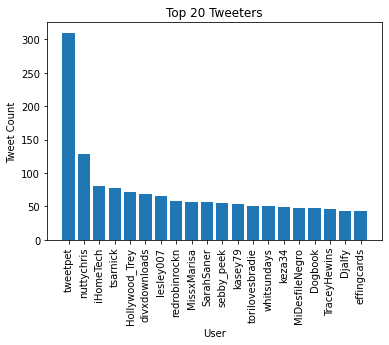

In [0]:
top_20_users = user_tweet_counts_sorted.limit(20).toPandas() #Plotting the top 20 users
plt.bar(top_20_users["user"], top_20_users["tweet_count"])
plt.xlabel("User")
plt.ylabel("Tweet Count")
plt.title("Top 20 Tweeters")
plt.xticks(rotation=90)
plt.show()


## 5.0 Transform the Bronze Data to Silver Data using a stream
- setup a read stream on your bronze delta table
- setup a write stream to append to the silver delta table
- Use the defined SILVER_CHECKPOINT and SILVER_DELTA paths in the includes
- name your bronze to silver stream as silver_stream
- transform the bronze data to the silver data using the data definition at the top of the notebook

In [0]:
# timestamp - convert date string in the bronze data to a timestamp
# mention - every @username mentioned in the text string in the bronze data gets a row in this silver data table.
# cleaned_text - the bronze text data with the mentions (@username) removed.
# sentiment - the given sentiment that was associated with the text in the bronze table.


# Define Pandas UDF to extract mentions
@pandas_udf(ArrayType(StringType()), PandasUDFType.SCALAR)
def extract_mentions_udf(text_series):
    return text_series.str.findall("@\w+")

# Define transformation pipeline
silver_stream = (spark.readStream
                .load(BRONZE_DELTA)
                .withColumn("timestamp", to_timestamp(col("date"), "EEE MMM dd HH:mm:ss z yyyy")) 
                .withColumn("cleaned_text", regexp_replace(col("text"), "@[A-Za-z0-9_]+","")) 
                .withColumn("mention", explode(extract_mentions_udf(col("text")))) 
                .select("timestamp", "cleaned_text", "mention", "sentiment")
                   )

                         
                         

/databricks/spark/python/pyspark/sql/pandas/functions.py:392: UserWarning: In Python 3.6+ and Spark 3.0+, it is preferred to specify type hints for pandas UDF instead of specifying pandas UDF type which will be deprecated in the future releases. See SPARK-28264 for more details.
  warnings.warn(


In [0]:
#Writing the Silver Stream
write_ss = (silver_stream.writeStream
            .option("mergeSchema","true")
            .option("checkPointLocation",SILVER_CHECKPOINT)
            .start(SILVER_DELTA)

)


In [0]:
silver_df = spark.read.load(SILVER_DELTA)

In [0]:
display(silver_df)

timestamp,cleaned_text,mention,sentiment
2009-05-02T13:02:40.000+0000,"""control"" or ""abuse""? I see them as Very different. Whilst we are into self promoting here goes http://tinyurl.com/cru3hu",@TextTonic,positive
2009-05-02T12:42:18.000+0000,".ahh, Im scared about swine flu too. its like ""level 5"" or something. don't know what it means though. haha. England loves youu",@ddlovato,positive
2009-05-02T12:47:06.000+0000,. Did you go on it!? I went on it in November & tried to do the tune tom hanks did in the film! Oh & stood next to Russell brand,@hlsidle,positive
2009-05-02T12:42:32.000+0000,tempted to make one this afternoon!Everytime I see someone with one I have 2 stop myself from yanking it out of their hands!,@leehancock,positive
2009-05-02T12:52:16.000+0000,"Are you sure? Gah I'm really embarrassed now >.< If so, big thanks! Um.. it's Watashi ni xx Shinasai and Arisa? Again, thanks!",@eksentrik,positive
2009-05-02T12:42:26.000+0000,Just back from #geocaching the caches I failed at last time... got one... failed again on the other (via ) http://bit.ly/bfXD1,@ribzlike,negative
2009-05-02T12:42:42.000+0000,i might be on a bit tomorrow. but mum's going overseas for ten days so i won't have regular access till the 14th :'( sorry!!,@TheTreelo,negative
2009-05-02T12:47:44.000+0000,you never know until you try. ;) everybody kept saying i would look like an idiot with red... do i look like one? (yesss),@Michaela1791,positive
2009-05-02T10:16:59.000+0000,awww saw 's chi vi at the usual 1st & 3rd friday spot along with aka BABY PAUL!!! now i'm randomly wide awake!,@nessanguyen,negative
2009-05-02T10:16:59.000+0000,awww saw 's chi vi at the usual 1st & 3rd friday spot along with aka BABY PAUL!!! now i'm randomly wide awake!,@PaulQT_Ran,negative


## 6.0 Transform the Silver Data to Gold Data using a stream
- setup a read stream on your silver delta table
- setup a write stream to append to the gold delta table
- Use the defined GOLD_CHECKPOINT and GOLD_DELTA paths defines in the includes
- name your silver to gold stream as gold_stream
- transform the silver data to the gold data using the data definition at the top of the notebook
- Load the pretrained transformer sentiment classifier from the MODEL_NAME at the production level from the MLflow registry
- Use a spark UDF to parallelize the inference across your silver data

In [0]:

# Load model from MLflow registry
model_uri = "models:/HF_TWEET_SENTIMENT/Production"
model = mlflow.pyfunc.spark_udf(spark, model_uri=model_uri)

/local_disk0/.ephemeral_nfs/envs/pythonEnv-7321d918-34a5-4462-925a-b49fffb84c42/lib/python3.9/site-packages/mlflow/store/artifact/utils/models.py:32: FutureWarning: ``mlflow.tracking.client.MlflowClient.get_latest_versions`` is deprecated since 2.9.0. Model registry stages will be removed in a future major release. To learn more about the deprecation of model registry stages, see our migration guide here: https://mlflow.org/docs/2.12.2/model-registry.html#migrating-from-stages
  latest = client.get_latest_versions(name, None if stage is None else [stage])


2024/05/12 00:53:41 INFO mlflow.store.artifact.artifact_repo: The progress bar can be disabled by setting the environment variable MLFLOW_ENABLE_ARTIFACTS_PROGRESS_BAR to false
2024/05/12 00:53:45 WARNING mlflow.utils.requirements_utils: Detected one or more mismatches between the model's dependencies and the current Python environment:
 - mlflow (current: 2.12.2, required: mlflow==2.11.3)
To fix the mismatches, call `mlflow.pyfunc.get_model_dependencies(model_uri)` to fetch the model's environment and install dependencies using the resulting environment file.
2024/05/12 00:53:45 WARNING mlflow.pyfunc: Calling `spark_udf()` with `env_manager="local"` does not recreate the same environment that was used during training, which may lead to errors or inaccurate predictions. We recommend specifying `env_manager="conda"`, which automatically recreates the environment that was used to train the model and performs inference in the recreated environment.


2024/05/12 00:53:45 INFO mlflow.models.flavor_backend_registry: Selected backend for flavor 'python_function'


In [0]:

gold_stream = (spark.readStream.load(SILVER_DELTA)
        .withColumn("predicted_sentiment", model(col("cleaned_text")))
        .withColumn("sentiment_id", when(col("sentiment") == "positive", 1).otherwise(0))
        .withColumn("predicted_sentiment_id", 
                    when(col("predicted_sentiment.label").isin(["NEU", "NEG"]), 0)
                    .when(col("predicted_sentiment.label") == "POS", 1)
                    .otherwise(0))  
        .select(col("timestamp"), col("mention"), col("cleaned_text"), col("sentiment"), 
                col("predicted_sentiment.label").alias("predicted_sentiment"), col("sentiment_id"), 
                col("predicted_sentiment.score").alias("predicted_score"),col('predicted_sentiment_id'))
)


In [0]:
write_gs = (gold_stream.writeStream
            .option("mergeSchema","true")
            .option("checkPointLocation",GOLD_CHECKPOINT)
            .start(GOLD_DELTA)

)

In [0]:
%fs ls "/tmp/labuser104917-3007335/gold.delta"


path,name,size,modificationTime
dbfs:/tmp/labuser104917-3007335/gold.delta/_delta_log/,_delta_log/,0,1715475227437
dbfs:/tmp/labuser104917-3007335/gold.delta/part-00000-6c076102-1294-4399-9719-c12cb5fb040b-c000.snappy.parquet,part-00000-6c076102-1294-4399-9719-c12cb5fb040b-c000.snappy.parquet,18020,1715445552000
dbfs:/tmp/labuser104917-3007335/gold.delta/part-00000-d7e140bb-67d7-4029-890d-cc57bc08a926-c000.snappy.parquet,part-00000-d7e140bb-67d7-4029-890d-cc57bc08a926-c000.snappy.parquet,3036359,1715465042000
dbfs:/tmp/labuser104917-3007335/gold.delta/part-00001-0914c1f9-a06a-40a6-b31b-e26a8930e754-c000.snappy.parquet,part-00001-0914c1f9-a06a-40a6-b31b-e26a8930e754-c000.snappy.parquet,12851,1715445546000
dbfs:/tmp/labuser104917-3007335/gold.delta/part-00001-c99a4c51-2724-4e85-9a88-0104996538c7-c000.snappy.parquet,part-00001-c99a4c51-2724-4e85-9a88-0104996538c7-c000.snappy.parquet,2026349,1715463750000
dbfs:/tmp/labuser104917-3007335/gold.delta/part-00002-38de4e0f-7f02-4f4d-89ec-5399acbf6950-c000.snappy.parquet,part-00002-38de4e0f-7f02-4f4d-89ec-5399acbf6950-c000.snappy.parquet,10757,1715445545000
dbfs:/tmp/labuser104917-3007335/gold.delta/part-00002-e63a05d7-cad2-4617-bfe8-e4129049938d-c000.snappy.parquet,part-00002-e63a05d7-cad2-4617-bfe8-e4129049938d-c000.snappy.parquet,1380738,1715462927000
dbfs:/tmp/labuser104917-3007335/gold.delta/part-00003-2a2373ce-ede4-4b80-a0cb-70a43918abab-c000.snappy.parquet,part-00003-2a2373ce-ede4-4b80-a0cb-70a43918abab-c000.snappy.parquet,559161,1715460863000
dbfs:/tmp/labuser104917-3007335/gold.delta/part-00003-3e1da78f-5384-40f5-99b6-38e00c7d4c15-c000.snappy.parquet,part-00003-3e1da78f-5384-40f5-99b6-38e00c7d4c15-c000.snappy.parquet,6139,1715445534000


In [0]:
display(dbutils.fs.ls('dbfs:/tmp/labuser104917-3007335/gold.delta/_delta_log/'))


path,name,size,modificationTime
dbfs:/tmp/labuser104917-3007335/gold.delta/_delta_log/.s3-optimization-0,.s3-optimization-0,0,1715445553000
dbfs:/tmp/labuser104917-3007335/gold.delta/_delta_log/.s3-optimization-1,.s3-optimization-1,0,1715445553000
dbfs:/tmp/labuser104917-3007335/gold.delta/_delta_log/.s3-optimization-2,.s3-optimization-2,0,1715445553000
dbfs:/tmp/labuser104917-3007335/gold.delta/_delta_log/00000000000000000000.crc,00000000000000000000.crc,6883,1715445553000
dbfs:/tmp/labuser104917-3007335/gold.delta/_delta_log/00000000000000000000.json,00000000000000000000.json,6104,1715445552000
dbfs:/tmp/labuser104917-3007335/gold.delta/_delta_log/00000000000000000001.crc,00000000000000000001.crc,11288,1715465046000
dbfs:/tmp/labuser104917-3007335/gold.delta/_delta_log/00000000000000000001.json,00000000000000000001.json,5143,1715465043000


In [0]:
gold_df = spark.read.load(GOLD_DELTA)

In [0]:
display(gold_df)

timestamp,mention,cleaned_text,sentiment,predicted_sentiment,sentiment_id,predicted_score,predicted_sentiment_id
2009-05-04T10:57:46.000+0000,@girltrumpet,yeahh idk if i like owen anymore though... i kinda lost respect for him in an episode i recorded...,positive,NEG,1,0.9772611260414124,0
2009-05-04T10:58:03.000+0000,@aworldinside,"ngl, my favourite thing about wikipedia sometimes is that it makes wookiepedia such an easy pisstake.",positive,POS,1,0.9795165061950684,1
2009-05-04T10:51:10.000+0000,@davidvisser,learnt my lesson today - don't go to work with a hangover when you work with kids make me a coffee pls,negative,NEU,0,0.5141188502311707,0
2009-05-04T10:53:14.000+0000,@cnn,Any others jobs like this available? Sounds like a great experience. Direct message if you know of any others.,positive,POS,1,0.9894245862960815,1
2009-05-04T10:53:20.000+0000,@scottcmusic,"I was in row P, but i tried to run down to the front in Corrupted and i could see you singing away",positive,NEU,1,0.9179950952529907,0
2009-05-04T10:47:21.000+0000,@emzyjonas,"haha yea, little bill. i used to cry on the christmas episode when the grandma couldnt come home :L x",negative,POS,0,0.5209638476371765,1
2009-05-04T10:57:06.000+0000,@moetkelly,lol i stay logged in facebook but i cant write anybody... and get off twitter!!...lol hooyea navy!... lol,negative,NEU,0,0.5909809470176697,0
2009-05-04T10:58:04.000+0000,@maprangmalts,"NO I still in office!!!! Welcome to my new life. Going now, I look forward to the 1 hour ride home...not",negative,NEG,0,0.5141425728797913,0
2009-05-04T10:37:39.000+0000,@profkhai,"Here are some that other tweeple recommend to me: www.audiomicro.com , http://tr.im/gWOy , http://tr.im/gWPx",positive,NEU,1,0.7077433466911316,0
2009-05-04T10:38:28.000+0000,@FotoWala,wow! I've joined the photography scene pretty recently so this (large format) makes it even more interesting,positive,POS,1,0.9900880455970764,1


## 7.0 Capture the accuracy metrics from the gold table in MLflow
Store the following in an MLflow experiment run:
- Store the precision, recall, and F1-score as MLflow metrics
- Store an image of the confusion matrix as an MLflow artifact
- Store the mdoel name and the MLflow version that was used as an MLflow parameters
- Store the version of the Delta Table (input-silver) as an MLflow parameter

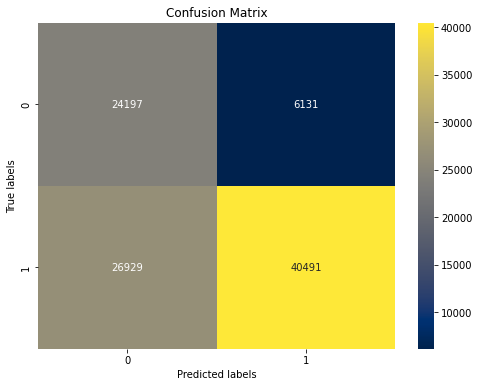

In [0]:
# Calculate evaluation metrics
y_true = gold_df.select("sentiment_id").rdd.flatMap(lambda x: x).collect()
y_pred = gold_df.select("predicted_sentiment_id").rdd.flatMap(lambda x: x).collect()

precision, recall, f1, _ = precision_recall_fscore_support(y_true, y_pred, average='weighted')
conf_matrix = confusion_matrix(y_true, y_pred)

# Log metrics and artifacts in MLflow
with mlflow.start_run() as run:
    # Log metrics
    mlflow.log_metric("precision", precision)
    mlflow.log_metric("recall", recall)
    mlflow.log_metric("f1-score", f1)
    
    # Log confusion matrix as artifact
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="cividis")
    plt.xlabel("Predicted labels")
    plt.ylabel("True labels")
    plt.title("Confusion Matrix")
    
    # Save confusion matrix plot as image
    confusion_matrix_image_path = "confusion_matrix.png"
    plt.savefig(confusion_matrix_image_path)
    
    # Log confusion matrix image as artifact
    mlflow.log_artifact(confusion_matrix_image_path, "confusion_matrices")
    
    # Log parameters
    mlflow.log_param("model_name", MODEL_NAME)
    mlflow.log_param("mlflow_version", mlflow.__version__)
    mlflow.log_param("delta_table_version", 1) #since there is only 1 json file in the delta log.
    



In [0]:
display(precision)

0.7458736540904141

## 8.0 Application Data Processing and Visualization
- How many mentions are there in the gold data total?
- Count the number of neutral, positive and negative tweets for each mention in new columns
- Capture the total for each mention in a new column
- Sort the mention count totals in descending order
- Plot a bar chart of the top 20 mentions with positive sentiment (the people who are in favor)
- Plot a bar chart of the top 20 mentions with negative sentiment (the people who are the vilians)

You may want to use the "Loop Application" widget to control whether you repeateded display the latest plots while the data comes in from your streams before moving on to the next section and cleaning up your run.

*note: A mention is a specific twitter user that has been "mentioned" in a tweet with an @user reference.

In [0]:
# ENTER YOUR CODE HERE

# Count distinct mentions
distinct_mentions_count = gold_df.select(countDistinct("mention")).collect()[0][0]

# Display the count of distinct mentions
print("Count of distinct mentions:", distinct_mentions_count)




Count of distinct mentions: 64828


In [0]:
# Counting neutral, positive, and negative tweets for each mention for the "predicted_sentiment"
mention_sentiment_counts = gold_df.groupBy("mention").agg(
    count(when(col("predicted_sentiment") == "NEU", True)).alias("neutral_count"),
    count(when(col("predicted_sentiment") == "POS", True)).alias("positive_count"),
    count(when(col("predicted_sentiment") == "NEG", True)).alias("negative_count")
)

In [0]:
display(mention_sentiment_counts)

mention,neutral_count,positive_count,negative_count
@moetkelly,1,0,0
@chuckwelch,1,0,0
@welshmermaid,1,1,0
@StaceysJustFab,0,1,0
@didactylos,1,2,0
@palinn,3,1,0
@cliuless,0,0,2
@AhoyJaz,0,1,0
@facebook,2,0,0
@NimbleRareFox,0,1,0


In [0]:
gold_df = spark.read.load(GOLD_DELTA)

In [0]:
mention_data = gold_df.groupBy("mention").agg(
    count("*").alias("total_mentions"),
    count(when(col("predicted_sentiment") == "NEU", True)).alias("neutral_count"),
    count(when(col("predicted_sentiment") == "POS", True)).alias("positive_count"),
    count(when(col("predicted_sentiment") == "NEG", True)).alias("negative_count")
)




In [0]:
mention_data = mention_data.withColumn(
    "total_count", col("neutral_count") + col("positive_count") + col("negative_count")
)

# Sorting the data by total count in descending order
total_mention_data = mention_data.orderBy(col("total_count").desc())

In [0]:
display(total_mention_data)

mention,total_mentions,neutral_count,positive_count,negative_count,total_count
@mileycyrus,608,115,417,76,608
@tommcfly,444,108,287,49,444
@ddlovato,432,97,290,45,432
@JonathanRKnight,244,61,149,34,244
@taylorswift13,159,21,119,19,159
@DavidArchie,152,33,99,20,152
@aplusk,148,50,71,27,148
@dougiemcfly,142,40,75,27,142
@stephenfry,141,40,63,38,141
@DonnieWahlberg,140,30,84,26,140


In [0]:
top_positive_mentions = mention_data.orderBy(col('positive_count').desc()).limit(20).toPandas()

In [0]:
display(top_positive_mentions)

mention,total_mentions,neutral_count,positive_count,negative_count,total_count
@mileycyrus,608,115,417,76,608
@ddlovato,432,97,290,45,432
@tommcfly,444,108,287,49,444
@JonathanRKnight,244,61,149,34,244
@taylorswift13,159,21,119,19,159
@DavidArchie,152,33,99,20,152
@selenagomez,119,18,93,8,119
@Jonasbrothers,110,14,90,6,110
@DonnieWahlberg,140,30,84,26,140
@dannywood,112,18,80,14,112


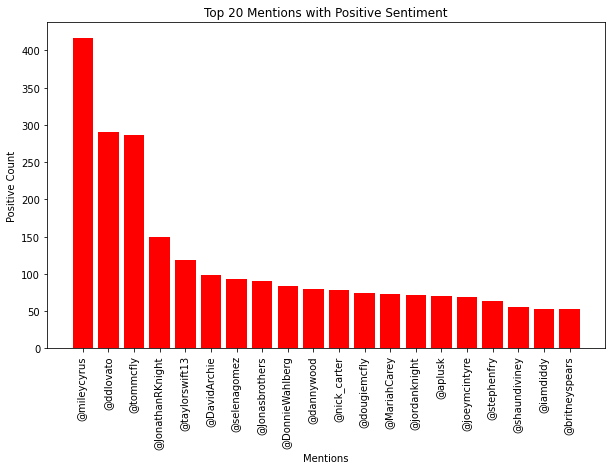

In [0]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 6))
plt.bar(top_positive_mentions["mention"], top_positive_mentions["positive_count"], color='red')
plt.xlabel('Mentions')
plt.ylabel('Positive Count')
plt.title('Top 20 Mentions with Positive Sentiment')
plt.xticks(rotation=90)
plt.show()




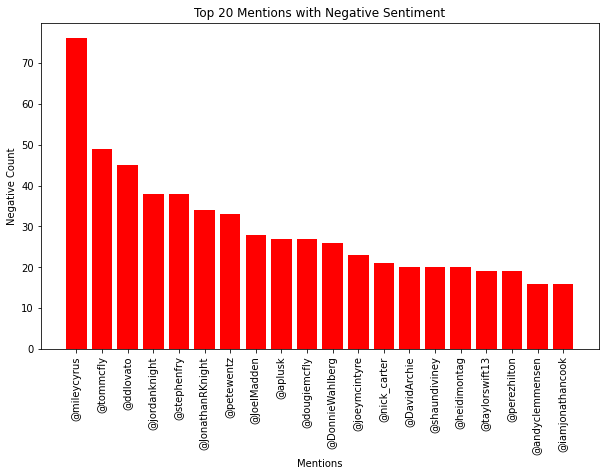

In [0]:
# Filter top 20 mentions with negative sentiment
top_negative_mentions = mention_data.orderBy(col('negative_count').desc()).limit(20).toPandas()


# Plot bar chart for top 20 mentions with negative sentiment
plt.figure(figsize=(10, 6))
plt.bar(top_negative_mentions["mention"], top_negative_mentions["negative_count"], color='red')
plt.xlabel('Mentions')
plt.ylabel('Negative Count')
plt.title('Top 20 Mentions with Negative Sentiment')
plt.xticks(rotation=90)
plt.show()


In [0]:
application_df = gold_df.groupBy("mention").agg(
    min(col("timestamp")).alias("mintimestamp"),
    max(col("timestamp")).alias("maxtimestamp"),
    count(when(col("predicted_sentiment") == "NEU", True)).alias("neutral_count"),
    count(when(col("predicted_sentiment") == "POS", True)).alias("positive_count"),
    count(when(col("predicted_sentiment") == "NEG", True)).alias("negative_count")
)


In [0]:
display(application_df)

mention,mintimestamp,maxtimestamp,neutral_count,positive_count,negative_count
@moetkelly,2009-05-04T10:57:06.000+0000,2009-05-04T10:57:06.000+0000,1,0,0
@chuckwelch,2009-05-04T10:42:40.000+0000,2009-05-04T10:42:40.000+0000,1,0,0
@welshmermaid,2009-04-19T09:13:27.000+0000,2009-05-04T10:43:18.000+0000,1,1,0
@StaceysJustFab,2009-05-04T13:39:07.000+0000,2009-05-04T13:39:07.000+0000,0,1,0
@didactylos,2009-04-18T21:54:54.000+0000,2009-05-04T13:54:07.000+0000,1,2,0
@palinn,2009-04-21T09:41:04.000+0000,2009-05-04T10:43:30.000+0000,3,1,0
@cliuless,2009-05-04T04:45:55.000+0000,2009-05-04T06:15:40.000+0000,0,0,2
@AhoyJaz,2009-05-04T06:01:52.000+0000,2009-05-04T06:01:52.000+0000,0,1,0
@facebook,2009-04-20T11:14:17.000+0000,2009-05-04T08:36:21.000+0000,2,0,0
@NimbleRareFox,2009-05-04T08:17:19.000+0000,2009-05-04T08:17:19.000+0000,0,1,0


## 9.0 Clean up and completion of your pipeline
- using the utilities what streams are running? If any.
- Stop all active streams
- print out the elapsed time of your notebook.

In [0]:
from pyspark.sql import SparkSession
import time

spark = SparkSession.builder \
    .appName("Active Streaming Queries") \
    .getOrCreate()

streaming_query_manager = spark.streams
active_streams = streaming_query_manager.active
for stream in active_streams:
    try:
        stream.stop()
        print("Stopped stream:", stream.id)
    except Exception as e:
        print("Error stopping stream:", stream.id)
        print("Exception:", e)


#three streams(bronze,silver,gold streams) stopped.

Stopped stream: 1374200a-4c6b-4c77-ad31-e7a249a20d19
Stopped stream: 53ac1992-d271-4a49-bff0-ccf824788637
Stopped stream: 8b1107be-7911-46b0-8fac-1e1afedf75d4


In [0]:
# Get the notebooks ending time note START_TIME was established in the include file when the notebook started.
END_TIME = time.time()

In [0]:
END_TIME

Out[8]: 1715480893.400331

## 10.0 How Optimized is your Spark Application (Grad Students Only)
Graduate students (registered for the DSCC-402 section of the course) are required to do this section.  This is a written analysis using the Spark UI (link to screen shots) that support your analysis of your pipelines execution and what is driving its performance.
Recall that Spark Optimization has 5 significant dimensions of considertation:
- Spill: write to executor disk due to lack of memory
- Skew: imbalance in partition size
- Shuffle: network io moving data between executors (wide transforms)
- Storage: inefficiency due to disk storage format (small files, location)
- Serialization: distribution of code segments across the cluster

Comment on each of the dimentions of performance and how your impelementation is or is not being affected.  Use specific information in the Spark UI to support your description.  

Note: you can take sreenshots of the Spark UI from your project runs in databricks and then link to those pictures by storing them as a publicly accessible file on your cloud drive (google, one drive, etc.)

References:
- [Spark UI Reference Reference](https://spark.apache.org/docs/latest/web-ui.html#web-ui)
- [Spark UI Simulator](https://www.databricks.training/spark-ui-simulator/index.html)

### ENTER YOUR MARKDOWN HERE

* Spill - No spill happened in all the jobs. All the stages look perfectly fine all the size of the files looks equal.
* Skew - No skew oberserved in the tasks.
* Shuffle - Due to the usage of the adaptive quey optimization and broadcast joins while using widetransformations like groupBy,aggregate no issues occured related to shuffle. All the the stages looks good where we used wide transformations attached the job stage event timeline in the google docs for the groupby() method.
* Storage - Deserialization time can be affected by storage-related issues, such as reading data from disk or retrieving it from cache. If data is stored inefficiently or requires extensive deserialization, it can contribute to increased deserialization time. Since we used delta table it will join the small files and automatically optimize it but still its affecting it some what for some stages proff attached in the gooogle docs.
* Serialization - I used udfs for for creating dataframes and while loading th emodel i used spark_udf.

https://drive.google.com/drive/folders/1s3DBpibHyU-FL1EJN8zcYFQy8HUY3gNP?usp=drive_link

